In [34]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly as py
import statsmodels.api as sm
import scipy
import folium
from folium import plugins

pd.set_option('display.max_columns', 135)
plt.rcParams['figure.figsize'] = (15, 6)
plt.style.use('fivethirtyeight')
import warnings
warnings.filterwarnings('ignore')

## Содержание

* [Первичный анализ данных](#header1)
* [Предобработка данных](#header2)
* [Визуальный анализ даных](#header3)
* [Проверка статистических гипотез](#header4)
* [Предсказание временного ряда](#header5)
* [Выводы](#header6)

*В данной работе анализируется активность террористических организаций. Цель этой работы -- продемонстрировать опасность и угрозу терроризма. Материалы предоставлены исключительно в ознакомительных целях, и я призываю к противодействию угрозе.*

*Многие террористические организации, представленные в данном датасете, запрещены в РФ. Если это не указано явно (например, на таблицах), это подразумевается.*

# Первичный анализ данных <a class="anchor" id="header1"></a>

https://www.kaggle.com/START-UMD/gtd

**GTD -- открытая база данных террористических атак по всему миру с 1970 по 2017 годы.** Датасет включает данные по более 180.000 атак. База данных поддерживается Национальным Консорциумом по Изучению и Противодействию Терроризму (START) (https://start.umd.edu/gtd/).

**Цель изучения датасета** -- исследование закономерностей террористических атак по всему миру, взаимосвязей стран, мотивов и преступных группировок. Будут проверены статистические гипотезы и проведена попытка предсказания временного ряда.

Подробная информация о датасете, признаках и методологии: [Codebook](https://start.umd.edu/gtd/downloads/Codebook.pdf).

### ID и дата

| Признак | Описание |
| :---: | :---: |
| ~~eventid~~ |ID атаки|
| iyear, imonth, iday | Дата начала атаки; если imonth/iday атаки с 1970 по 2011 неизвестны, то указывается 0, иначе среднее число по данным из СМИ |
| ~~approxdate~~ | Примерная дата; не Nan в том случае, когда неизвестны imonth/iday |
| extended | Если атака длилась больше 24 часов, то 1, иначе 0 |
| ~~resolution~~ | Если extended==1, то указывается дата окончания инцидента |

### Информация об инциденте

| Признак | Описание |
| :---: | :---: |
| ~~summary~~ | Краткое описание атаки |
| crit1| 1, если цель политическая, экономическая, религиозная или социальная |
| crit2| 1, если цель -- убеждение, устрашение или разглашение идеи публике |
| crit3| 1, если вне международного гуманитарного закона |
| doubtterr| 1, если нет уверенности, что это террористическая атака |
| ~~alternative~~, ~~alternative_txt~~ | Альтернативная интерпретация атаки, если не терроризм, при doubterr==1 |
| ~~multiple~~, ~~related~~| Связь с другими атаками; если связь есть, то multiple=1 и в related перечислены eventid чере запятую|

### Местоположение инцидента

| Признак | Описание |
| :---: | :---: |
| country, country_txt | Код и название страны |
| region, region_txt | Код и название региона |
| provstate, city, ~~vicinity~~ | Штат/провинция, город и идентификатор того, что атака произошла в окрестности города |
| ~~location~~ | Дополнительная информация о местоположении |
| latitude, longitude | Широта и долгота города, в котором произошел инцидент |
| ~~specificity~~ | Геоточность указания широты и долготы |

### Информация об атаке

| Признак | Описание |
| :---: | :---: |
| attacktype1, attacktype1_txt<br>~~attacktype2~~, ~~attacktype2_txt~~<br>~~attacktype3~~, ~~attacktype3_txt~~ | Тип атаки, где attacktype1 -- основной тип.<br>1 -- убийство определенного человека/группы лиц<br>2 -- вооруженное нападение<br>3 -- взрыв<br>4 -- угон<br>5 -- захват заложников<br>6 -- похищение людей<br>7 -- разрушение инфраструктуры<br>8 -- невоорженное нападение<br>9 -- неизвестно|
| success | Ели атака успешна, то 1 |
| suicide | Если атака суицидальная, то 1 |

### Информация об оружии

| Признак | Описание |
| :---: | :---: |
| weaptype1, weaptype1_txt<br>~~weaptype2~~, ~~weaptype2_txt~~<br>~~weaptype3~~, ~~weaptype3_txt~~<br>~~weaptype4~~, ~~weaptype4_txt~~ | Тип основного оружия и второстепенного оружия<br>1 -- биологическое оружие<br>2 -- химическое оружие<br>3 -- радиологическое оружие<br>4 -- ядерное оружие<br>5 -- огнестрельное оружие<br>6 -- взрывчатка<br>7 -- поддельное оружие<br>8 -- зажигательное оружие<br>9 -- рукопашное оружие<br>10 -- транспорт<br>11 -- саботаж<br>12 -- другое<br>13 -- неизвестно |
| weapsubtype1, weapsubtype1_txt<br>~~weapsubtype2~~, ~~weapsubtype2_txt~~<br>~~weapsubtype3~~, ~~weapsubtype3_txt~~<br>~~weapsubtype4~~, ~~weapsubtype4_txt~~ | Субтип основного и второстепенного оружия, расшифровку см. Codebook |
| ~~weapdetail~~ | Доп. информация о типе оружия |

### Информация о жертве/цели

| Признак | Описание |
| :---: | :---: |
| targtype1, targtype1_txt<br>~~targtype2~~, ~~targtype2_txt~~<br>~~targtype3~~, ~~targtype3_txt~~ | Основной тип цели. Полную расшифровку см. Codebook|
| targsubtype1, targsubtype1_txt<br>~~targsubtype2~~, ~~targsubtype2_txt~~<br>~~targsubtype3~~, ~~targsubtype3_txt~~ | Основной субтип цели. Полную расшифровку см. Codebook |
| corp1<br>~~corp2~~<br>~~corp3~~ | Корпорация или правительство |
| target1<br>~~target2~~<br>~~target3~~ | Конкретный человек или сооружение |
| natlty1, natlty1_txt<br>~~natlty2~~, ~~natlty2_txt~~<br>~~natlty3~~, ~~natlty3_txt~~ | Национальность цели |


### Информация о преступнике

| Признак | Описание |
| :---: | :---: |
| gname<br>~~gname2~~<br>~~gname3~~ | Преступная группировка. Стандартизованные названия в датасете |
| ~~gsubname~~<br>~~gsubname2~~<br>~~gsubname3~~ | Фракция преступной группировки |
| ~~guncertain1~~<br>~~guncertain2~~<br>~~guncertain3~~ | 1, если есть уверенность в принадлежности группировке |
| individual | 1, если преступник не связан ни с какой группировкой |
| nperps | Количество преступников |
| ~~nperpcap~~ | Количество захваченных преступников |
| claimed<br>~~claim2~~<br>~~claim3~~ | 1, если группа или человек взяли на себя ответственность |
| ~~claimmode~~, ~~claimmode_txt~~<br>~~claimmode2~~, ~~claimmode2_txt~~<br>~~claimmode3~~, ~~claimmode3_txt~~ | Способ взятия на себя ответственности. Полную расшифровку см. Codebook |
| ~~compclaim~~ | 1, если несколько групп взяли на себя ответственность |
| motive | Конкретный мотив атаки |

### Число жертв и последствия

| Признак | Описание |
| :---: | :---: |
| nkill, nwound | Количество всех погибших и раненых соответственно |
| ~~nkillus~~, ~~nwoundus~~ | Количество погибших и раненых соответственно граждан США |
| ~~nkillter~~, ~~nwoundte~~ | Количество погибших и раненых соответственно нападавших |
| property | 1, если было повреждено имущество |
| propextent, ~~propextent_txt~~ | Степень повреждения имущества (от слабого (3) до катастрофического (1)) |
| ~~propvalue~~ | Цена поврежденного имущества в долларах |
| ~~propcomment~~ | Дополнительная информация о поврежденном имуществе |
| ishostkid| 1, если жертва была захвачена в заложники/похищена |
| nhostkid | Число захваченных в заложники/похищенных |
| ~~nhostkidus~~ | Число захваченных в заложники/похищенных граждан США |
| ~~nhours~~, ~~ndays~~ | Сколько часов/дней удерживали заложников |
| ~~divert~~, ~~kidhijcountry~~ | Страны, в котороые увели или из которых похитили жертв соответственно |
| ~~ransom~~ | 1, если похитители потребовали денежный выкуп |
| ~~ransomamt~~, ~~ransompaid~~ | Величина потребованного и выплаченного выкупа |
| ~~ransomamtus~~, ~~ransompaidus~~ | Величина потребованного и выплаченного выкупа за граждан США |
| ~~ransomnote~~ | Дополнительная информация о выкупе |
| ~~hostkidoutcome~~, ~~hostkidoutcome_txt~~ | Результат захвата заложников. Полную расшифровку см. Codebook |
| nreleased | Число отпущенных заложников |

### Дополнительная информация и источники

| Признак | Описание |
| :---: | :---: |
| ~~addnotes~~ | Дополнительные комментарии |
| ~~INT_LOG~~ | 1, если атакующим потребовалось пересечь границы стран |
| ~~INT_IDEO~~ | 1, если преступники атаковали цель другой национальности |
| ~~INT_MISC~~ | 1, если место атаки отличается от национальности преступника/жертвы |
| INT_ANY | 1, если атака была интернациональной |
| ~~scite1~~<br>~~scite2~~<br>~~scite3~~ | Источники информации |
| ~~dbsource~~ | Оригинальная база данных |

Зачеркнутые признаки будут выкинуты из датасета.

**Фух, на этом все.**

In [2]:
df = pd.read_csv('data/globalterrorismdb.csv', dtype=object)

In [3]:
df.shape

(181691, 135)

In [4]:
df.tail()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,region_txt,provstate,city,latitude,longitude,specificity,vicinity,location,summary,crit1,crit2,crit3,doubtterr,alternative,alternative_txt,multiple,success,suicide,attacktype1,attacktype1_txt,attacktype2,attacktype2_txt,attacktype3,attacktype3_txt,targtype1,targtype1_txt,targsubtype1,targsubtype1_txt,corp1,target1,natlty1,natlty1_txt,targtype2,targtype2_txt,targsubtype2,targsubtype2_txt,corp2,target2,natlty2,natlty2_txt,targtype3,targtype3_txt,targsubtype3,targsubtype3_txt,corp3,target3,natlty3,natlty3_txt,gname,gsubname,gname2,gsubname2,gname3,gsubname3,motive,guncertain1,guncertain2,guncertain3,individual,nperps,nperpcap,claimed,claimmode,claimmode_txt,claim2,claimmode2,claimmode2_txt,claim3,claimmode3,claimmode3_txt,compclaim,weaptype1,weaptype1_txt,weapsubtype1,weapsubtype1_txt,weaptype2,weaptype2_txt,weapsubtype2,weapsubtype2_txt,weaptype3,weaptype3_txt,weapsubtype3,weapsubtype3_txt,weaptype4,weaptype4_txt,weapsubtype4,weapsubtype4_txt,weapdetail,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,propextent,propextent_txt,propvalue,propcomment,ishostkid,nhostkid,nhostkidus,nhours,ndays,divert,kidhijcountry,ransom,ransomamt,ransomamtus,ransompaid,ransompaidus,ransomnote,hostkidoutcome,hostkidoutcome_txt,nreleased,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
181686,201712310022,2017,12,31,NaN,0,NaN,182,Somalia,11,Sub-Saharan Africa,Middle Shebelle,Ceelka Geelow,2.359673,45.385034,2,0,The incident occurred near the town of Balcad.,12/31/2017: Assailants opened fire on a Somali...,1,1,0,1,1,Insurgency/Guerilla Action,0,1,0,2,Armed Assault,NaN,NaN,NaN,NaN,4,Military,36,Military Checkpoint,Somali National Army (SNA),Checkpoint,182,Somalia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Al-Shabaab,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,0,-99,0,1,10,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,Firearms,5,Unknown Gun Type,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,0,2,0,0,-9,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"""Somalia: Al-Shabaab Militants Attack Army Che...","""Highlights: Somalia Daily Media Highlights 2 ...","""Highlights: Somalia Daily Media Highlights 1 ...",START Primary Collection,0,0,0,0,NaN
181687,201712310029,2017,12,31,NaN,0,NaN,200,Syria,10,Middle East & North Africa,Lattakia,Jableh,35.407278,35.942679,1,1,The incident occurred at the Humaymim Airport.,12/31/2017: Assailants launched mortars at the...,1,1,0,1,1,Insurgency/Guerilla Action,0,1,0,3,Bombing/Explosion,NaN,NaN,NaN,NaN,4,Military,27,Military Barracks/Base/Headquarters/Checkpost,Russian Air Force,Hmeymim Air Base,167,Russia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Muslim extremists,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,0,-99,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6,Explosives,11,"Projectile (rockets, mortars, RPGs, etc.)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Mortars were used in the attack.,2,0,0,7,0,0,1,4,Unknown,-99,Seven military planes were damaged in this att...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"""Putin's 'victory' in Syria has turned into a ...","""Two Russian soldiers killed at Hmeymim base i...","""Two Russian servicemen killed in Syria mortar...",START Primary Collection,-9,-9,1,1,NaN
181688,201712310030,2017,12,31,NaN,0,NaN,160,Philippines,5,Southeast Asia,Maguindanao,Kubentog,6.900742,124.437908,2,0,The incident occurred in the Datu Hoffer distr...,12/31/2017: Assailants set fire to houses in K...,1,1,1,0,NaN,NaN,0,1,0,7,Facility/Infrastructure Attack,NaN,NaN,NaN,NaN,14,Private Citizens & Property,76,House/Apartment/Residence,Not Applicable,Houses,160,Philippines,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Bangsamoro Islamic Freedom Movement (BIFM),NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,0,-99,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,Incendiary,18,Arson/Fire,NaN,NaN,NaN,NaN,NaN,NaN,

# Предобработка данных <a class="anchor" id="header2"></a>

Удалим сначала зачеркнутые в таблицах выше колонки.

In [5]:
df.drop(['eventid', 'approxdate', 'resolution', 'summary', 'alternative', 'alternative_txt',\
         'multiple', 'related', 'vicinity', 'location', 'specificity', 'attacktype2', 'attacktype2_txt',\
        'attacktype3', 'attacktype3_txt', 'weaptype2', 'weaptype2_txt', 'weaptype3', 'weaptype3_txt',\
        'weaptype4', 'weaptype4_txt', 'weapsubtype2', 'weapsubtype2_txt', 'weapsubtype3',\
        'weapsubtype3_txt', 'weapsubtype4', 'weapsubtype4_txt', 'weapdetail', 'targtype2', 'targtype2_txt',\
        'targtype3', 'targtype3_txt', 'targsubtype2', 'targsubtype2_txt', 'targsubtype3',\
        'targsubtype3_txt', 'corp2', 'corp3', 'target2', 'target3', 'natlty2', 'natlty2_txt',\
        'natlty3', 'natlty3_txt', 'gname2', 'gname3', 'gsubname', 'gsubname2', 'gsubname3',\
        'guncertain1', 'guncertain2', 'guncertain3', 'nperpcap', 'claim2', 'claim3', 'claimmode', 'claimmode_txt',\
        'claimmode2', 'claimmode2_txt', 'claimmode3', 'claimmode3_txt', 'compclaim', 'nkillus', 'nwoundus',\
        'nkillter', 'nwoundte', 'propextent_txt', 'propvalue', 'propcomment', 'ishostkid',\
        'nhostkidus', 'nhours', 'ndays', 'divert', 'kidhijcountry', 'ransom', 'ransomamt', 'ransompaid',\
        'ransomamtus', 'ransompaidus', 'ransomnote', 'hostkidoutcome', 'hostkidoutcome_txt',\
        'addnotes', 'INT_LOG', 'INT_IDEO', 'INT_MISC', 'scite1', 'scite2', 'scite3', 'dbsource'], axis=1, inplace=True)

Так удобнее. Посмотрим на Nan.

In [6]:
df.tail()

,iyear,imonth,iday,extended,country,country_txt,region,region_txt,provstate,city,latitude,longitude,crit1,crit2,crit3,doubtterr,success,suicide,attacktype1,attacktype1_txt,targtype1,targtype1_txt,targsubtype1,targsubtype1_txt,corp1,target1,natlty1,natlty1_txt,gname,motive,individual,nperps,claimed,weaptype1,weaptype1_txt,weapsubtype1,weapsubtype1_txt,nkill,nwound,property,propextent,nhostkid,nreleased,INT_ANY
181686,2017,12,31,0,182,Somalia,11,Sub-Saharan Africa,Middle Shebelle,Ceelka Geelow,2.359673,45.385034,1,1,0,1,1,0,2,Armed Assault,4,Military,36,Military Checkpoint,Somali National Army (SNA),Checkpoint,182,Somalia,Al-Shabaab,NaN,0,-99,1,5,Firearms,5,Unknown Gun Type,1,2,-9,NaN,NaN,NaN,0
181687,2017,12,31,0,200,Syria,10,Middle East & North Africa,Lattakia,Jableh,35.407278,35.942679,1,1,0,1,1,0,3,Bombing/Explosion,4,Military,27,Military Barracks/Base/Headquarters/Checkpost,Russian Air Force,Hmeymim Air Base,167,Russia,Muslim extremists,NaN,0,-99,0,6,Explosives,11,"Projectile (rockets, mortars, RPGs, etc.)",2,7,1,4,NaN,NaN,1
181688,2017,12,31,0,160,Philippines,5,Southeast Asia,Maguindanao,Kubentog,6.900742,124.437908,1,1,1,0,1,0,7,Facility/Infrastructure Attack,14,Private Citizens & Property,76,House/Apartment/Residence,Not Applicable,Houses,160,Philippines,Bangsamoro Islamic Freedom Movement (BIFM),NaN,0,-99,0,8,Incendiary,18,Arson/Fire,0,0,1,4,NaN,NaN,0
181689,2017,12,31,0,92,India,6,South Asia,Manipur,Imphal,24.798346,93.94043,1,1,1,0,0,0,3,Bombing/Explosion,2,Government (General),21,Government Building/Facility/Office,Forest Department Manipur,Office,92,India,Unknown,NaN,0,-99,0,6,Explosives,7,Grenade,0,0,-9,NaN,NaN,NaN,-9
181690,2017,12,31,0,160,Philippines,5,Southeast Asia,Maguindanao,Cotabato City,7.209594,124.241966,1,1,1,0,0,0,3,Bombing/Explosion,20,Unknown,NaN,NaN,Unknown,Unknown,160,Philippines,Unknown,NaN,0,-99,0,6,Explosives,16,Unknown Explosive Type,0,0,0,NaN,NaN,NaN,-9


In [7]:
df.isna().sum()

iyear                    0
imonth                   0
iday                     0
extended                 0
country                  0
country_txt              0
region                   0
region_txt               0
provstate              421
city                   434
latitude              4556
longitude             4557
crit1                    0
crit2                    0
crit3                    0
doubtterr                1
success                  0
suicide                  0
attacktype1              0
attacktype1_txt          0
targtype1                0
targtype1_txt            0
targsubtype1         10373
targsubtype1_txt     10373
corp1                42550
target1                636
natlty1               1559
natlty1_txt           1559
gname                    0
motive              131130
individual               0
nperps               71115
claimed              66120
weaptype1                0
weaptype1_txt            0
weapsubtype1         20768
weapsubtype1_txt     20768
n

Кое-где их довольно много. Заполним подходящими значениями в зависимости от столбца, ориентируясь на Codebook.

provstate, city заполним значениями country_txt для указания метоположения.

In [8]:
df['provstate'].fillna(df['country_txt'], inplace=True)
df['city'].fillna(df['country_txt'], inplace=True)

latitude, longitude оставим Nan -- пригодится при построении карты как флаг того, что стоит дропнуть.

doubterr обработаем так: если значение 1, то дропнем ряды (ибо нет уверенности, что это террористическая атака). Затем дропнем всю колонку.

In [9]:
df.drop(df[df['doubtterr'] == 1].index, inplace=True)

In [10]:
df.drop(['doubtterr'], axis=1, inplace=True)

targsubtype1 и targsubtype1_txt заполним 0 и Unknown соответственно.

In [11]:
df['targsubtype1'].fillna(0, inplace=True)
df['targsubtype1_txt'].fillna('Unknown', inplace=True)

corp1 и target1 заполним Unknown.

In [12]:
df['corp1'].fillna('Unknown', inplace=True)
df['target1'].fillna('Unknown', inplace=True)

natlty1 и natlty1_txt заполним 0 и Unknown соответственно (не будем предполагать, что эти значения совпадают со значениями country и country_txt).

In [13]:
df['natlty1'].fillna(0, inplace=True)
df['natlty1_txt'].fillna('Unknown', inplace=True)

motive заполним значениями targtype1_txt.

In [14]:
df['motive'].fillna(df['targtype1_txt'], inplace=True)

nperps заполним значениями имеет значения Nan и -99 (все str). Переведем все Nan и Unknown в -99.

In [15]:
df['nperps'].fillna('-99', inplace=True)

claimed заменим на -9, согласно Codebook.

In [16]:
df['claimed'].fillna('-9', inplace=True)

wepsubtype1 и weapsubtype1_txt заполним 0 и Unknown соответственно.

In [17]:
df['weapsubtype1'].fillna(0, inplace=True)
df['weapsubtype1_txt'].fillna('Unknown', inplace=True)

nkill и nwound заполним 0.

In [18]:
df['nkill'].fillna(0, inplace=True)
df['nwound'].fillna(0, inplace=True)

propextent заполним в зависимости от property: если property 1/-9, то propextent 4 (Unknown), если property 0, то propextent 0. Затем дропнем колонку property.

In [19]:
df.loc[(df['propextent'].isna()) & (df['property'] == '0'), 'propextent'] = '0'
df['propextent'].fillna('4', inplace=True)

nhostkid и nreleased заполним 0.

In [20]:
df['nhostkid'].fillna(0, inplace=True)
df['nreleased'].fillna(0, inplace=True)

Приведем все, что можем, к int/float.

In [21]:
df = df.apply(pd.to_numeric, errors='ignore')

In [22]:
df['nwound'] = df['nwound'].astype(int)

Добавим колонку ncas=nkill+nwound.

In [23]:
df['ncas'] = df['nkill'] + df['nwound']

**Готово!**

In [24]:
df.shape

(181691, 44)

# Визуальный анализ данных <a class="anchor" id="header3"></a>

Некоторые базовые вещи, например, страны и регионы, наиболее пострадавшие от атак, и наибольшее число погибших.

In [368]:
print(f"Country with most terrorist attacks: {df['country_txt'].value_counts().index[0]}")
print(f"Region with most terrorist attacks: {df['region_txt'].value_counts().index[0]}")
print(f"Maximum people killed in the attack: {df['nkill'].max()} in {df.loc[df['nkill'].idxmax(), 'country_txt']}, {df.loc[df['nkill'].idxmax(), 'iyear']} by {df.loc[df['nkill'].idxmax(), 'gname']}")
print(f"Maximum casualities in the attack: {df['ncas'].max()} in {df.loc[df['ncas'].idxmax(), 'country_txt']}, {df.loc[df['ncas'].idxmax(), 'iyear']} by {df.loc[df['ncas'].idxmax(), 'gname']}")
print(f"Most active perpetrator groups:\n\t{df['gname'].value_counts().index[1]} : {df['gname'].value_counts()[1]}\n\t{df['gname'].value_counts().index[2]} : {df['gname'].value_counts()[2]}")

Country with most terrorist attacks: Iraq
Region with most terrorist attacks: Middle East & North Africa
Maximum people killed in the attack: 1570 in Iraq, 2014 by Islamic State of Iraq and the Levant (ISIL)
Maximum casualities in the attack: 9574 in United States, 2001 by Al-Qaida
Most active perpetrator groups:
	Taliban : 7478
	Islamic State of Iraq and the Levant (ISIL) : 5613


Построим зависимость числа террористических атак в год.

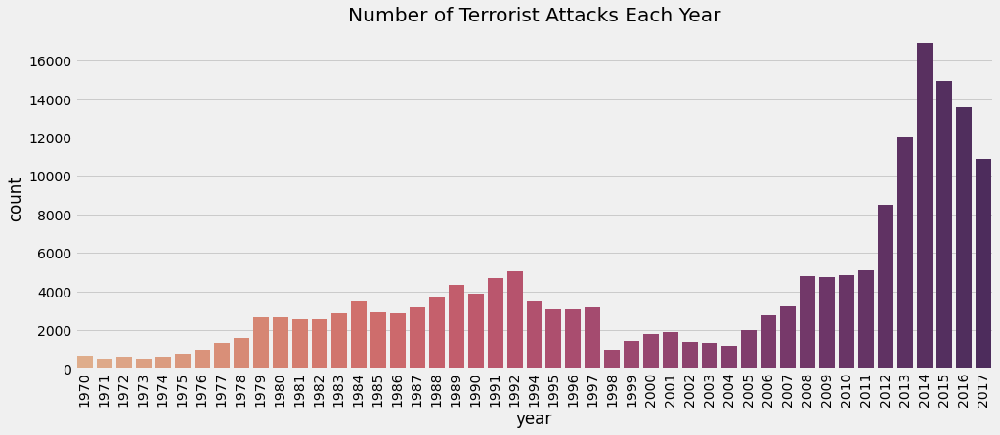

In [300]:
sns.countplot('iyear', data=df, palette='flare')
plt.xticks(rotation=90)
plt.xlabel("year")
plt.title("Number of Terrorist Attacks Each Year")
plt.show()

Видны спады и всплески числа террористических атак, наиболее заметный в 2013-2017 годах. Рассмотрим эти годы поближе.

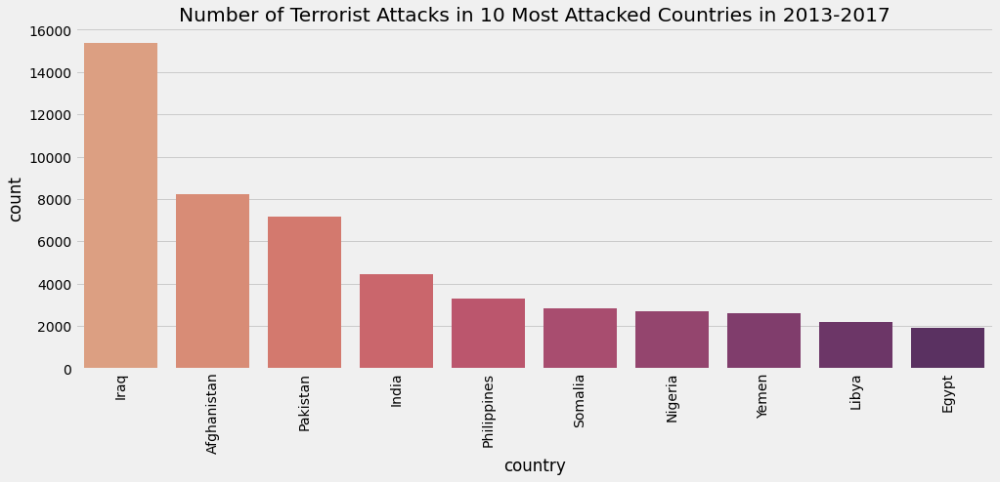

In [355]:
tmp = df[(df['iyear'] >= 2013) & (df['iyear'] <= 2017)]
sns.countplot('country_txt', data=tmp, palette='flare', order=tmp['country_txt'].value_counts().index[:10])
plt.xticks(rotation=90)
plt.xlabel("country")
plt.title("Number of Terrorist Attacks in 10 Most Attacked Countries in 2013-2017")
plt.show()

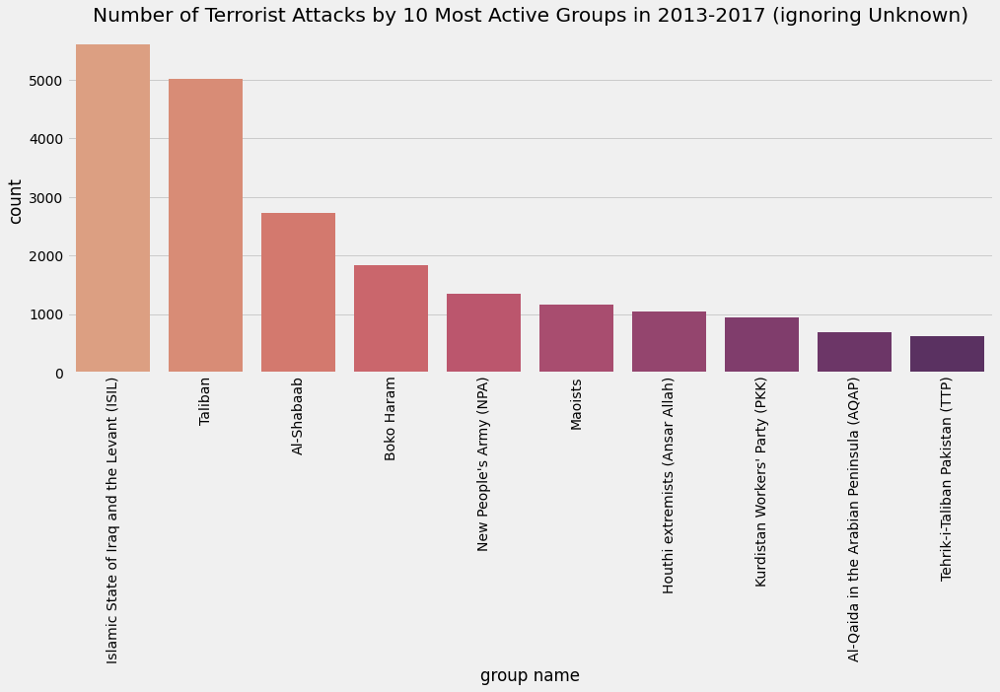

In [352]:
sns.countplot('gname', data=tmp, palette='flare', order=tmp['gname'].value_counts().index[1:11])
plt.xticks(rotation=90)
plt.xlabel('group name')
plt.title("Number of Terrorist Attacks by 10 Most Active Groups in 2013-2017 (ignoring Unknown)")
plt.show()

Большой всплеск терроризма в 2013-2017 годах, значительно происходивший в Ираке, может быть связан с войной в Ираке в те же годы ([War in Iraq](https://en.wikipedia.org/wiki/War_in_Iraq_(2013%E2%80%932017))). Большое число атак со стороны запрещенной в РФ организации ISIL также коррелирует с датами войны в Ираке.
Можно сделать вывод, что в данных наблюдается корреляция с происходящими вооруженными конфликтами и обстановкой в мире.

Исследуем теперь следующие вопросы за весь период, записанный в датасете:

Наиболее пораженные терроризмом страны.

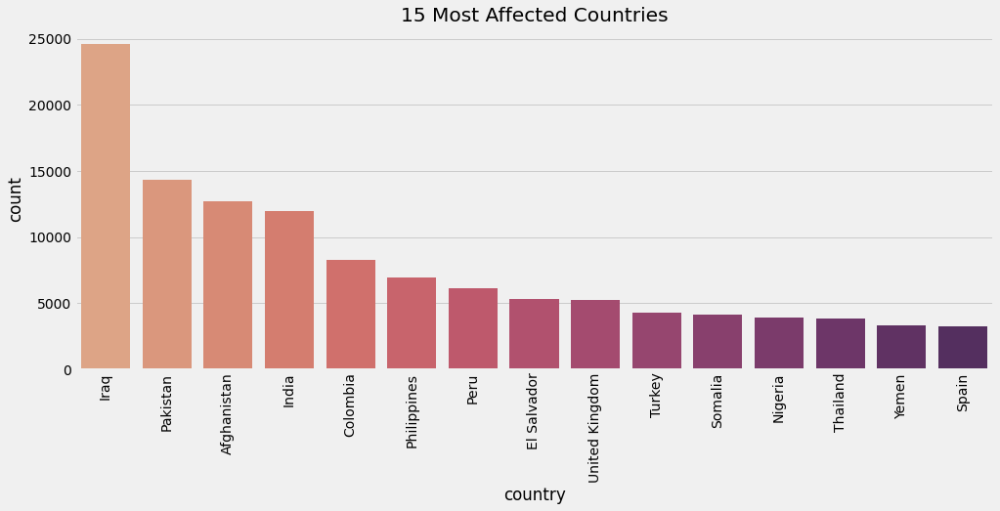

In [358]:
sns.countplot('country_txt', data=df, palette='flare', order=df['country_txt'].value_counts().index[:15])
plt.xticks(rotation=90)
plt.xlabel("country")
plt.title("15 Most Affected Countries")
plt.show()

Наиболее активные преступные группировки.

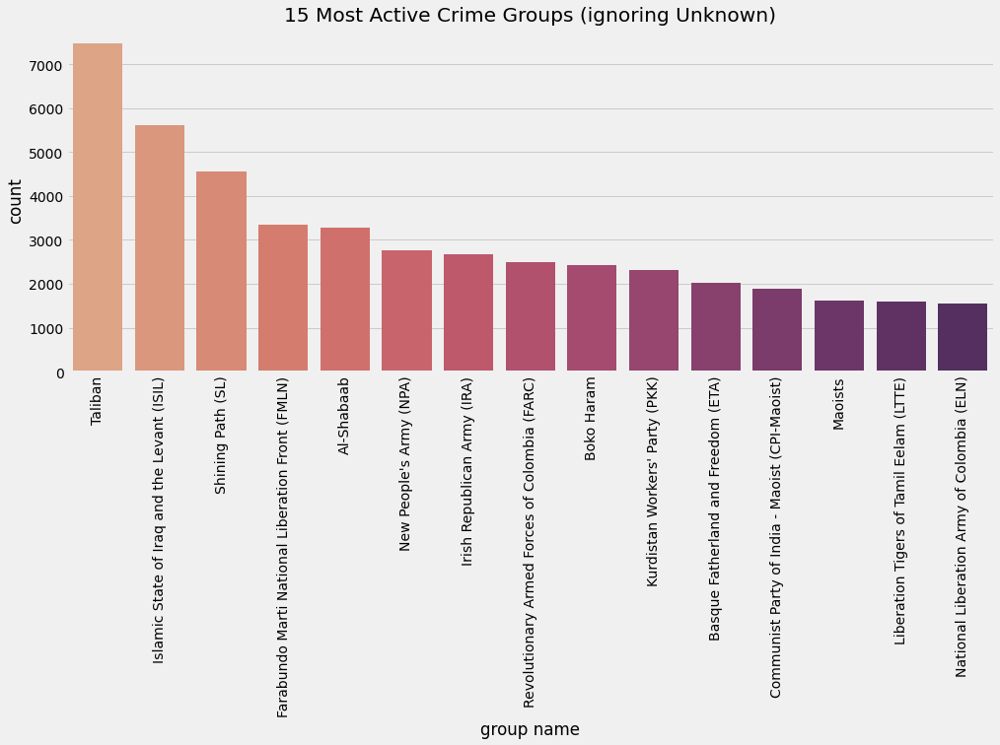

In [361]:
sns.countplot('gname', data=df, palette='flare', order=df['gname'].value_counts().index[1:16])
plt.xticks(rotation=90)
plt.xlabel("group name")
plt.title("15 Most Active Crime Groups (ignoring Unknown)")
plt.show()

Предпочитаемые типы атак.

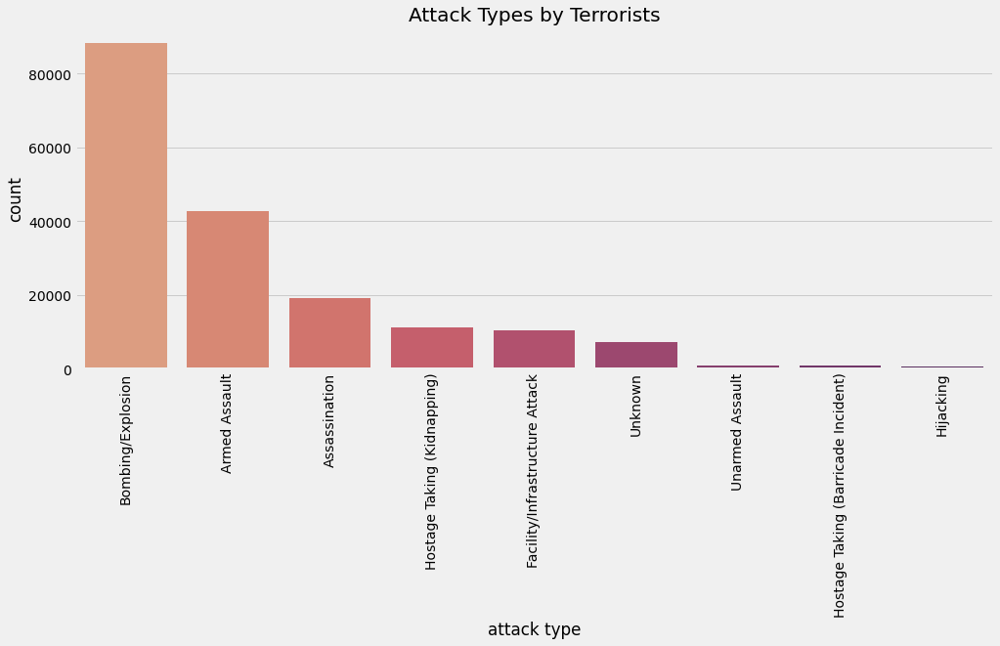

In [364]:
sns.countplot('attacktype1_txt', data=df, palette='flare', order=df['attacktype1_txt'].value_counts().index)
plt.xticks(rotation=90)
plt.xlabel("attack type")
plt.title("Attack Types by Terrorists")
plt.show()

Типы атак, приводящие к наибольшему числу жертв.

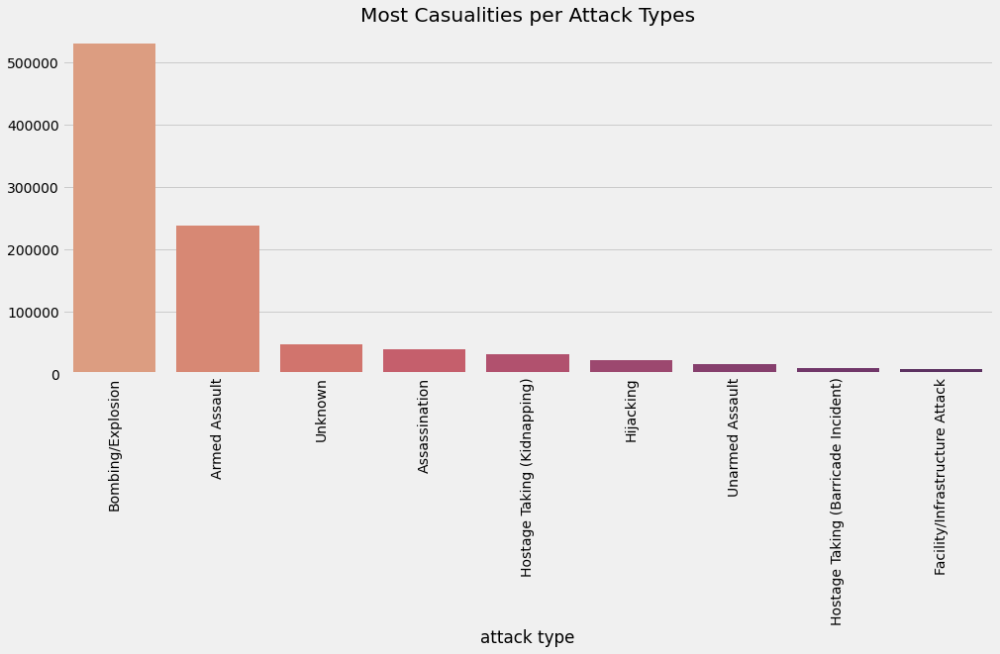

In [396]:
tmp = df.groupby('attacktype1_txt')['ncas'].sum().sort_values(ascending=False)
sns.barplot(x=tmp.index, y=tmp.values, palette='flare')
plt.xticks(rotation=90)
plt.xlabel("attack type")
plt.title("Most Casualities per Attack Types")
plt.show()

Предпочитаемые типы целей.

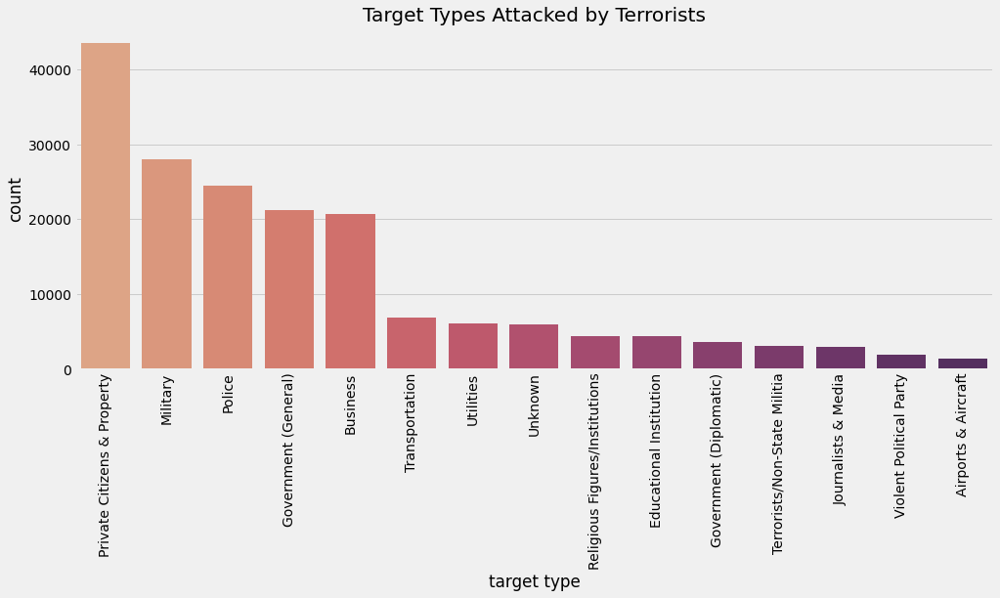

In [365]:
sns.countplot('targtype1_txt', data=df, palette='flare', order=df['targtype1_txt'].value_counts().index[:15])
plt.xticks(rotation=90)
plt.xlabel("target type")
plt.title("Target Types Attacked by Terrorists")
plt.show()

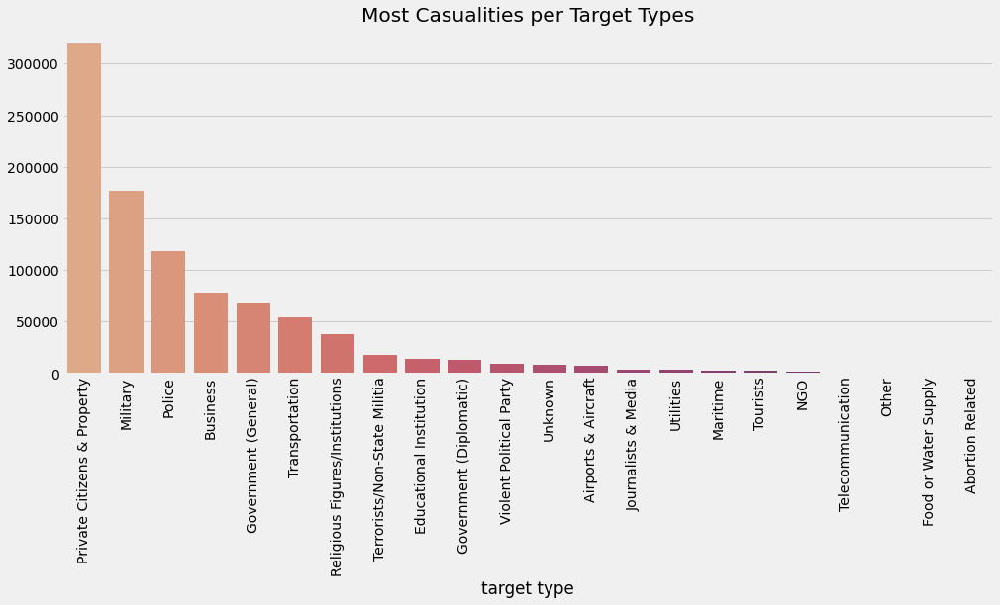

In [500]:
tmp = df.groupby('targtype1_txt')['ncas'].sum().sort_values(ascending=False)
sns.barplot(x=tmp.index, y=tmp.values, palette='flare')
plt.xticks(rotation=90)
plt.xlabel("target type")
plt.title("Most Casualities per Target Types")
plt.show()

Рассмотрим теперь географическое распределение террористических атак. Построим карту атак за 2014 год.

In [419]:
tmp = df[['latitude', 'longitude', 'iyear', 'imonth', 'iday', 'ncas', 'gname']]
tmp = tmp.dropna()

lats = tmp[tmp['iyear'] == 2014].latitude
longs = tmp[tmp['iyear'] == 2014].longitude
places=[[x[0],x[1]] for x in zip(lats,longs)]
months = tmp[tmp['iyear'] == 2014].imonth
days = tmp[tmp['iyear'] == 2014].iday
ncass = tmp[tmp['iyear'] == 2014].ncas
gnames = tmp[tmp['iyear'] == 2014].gname
info = zip(months, days, ncass, gnames)
popups = [f"{day}.{month}.2014<br>casualties: {ncas}<br>perpetrators: {gname}" for month, day, ncas, gname in info]

m = folium.Map(places[0], tiles = 'OpenStreetMap', zoom_start=2)
plugins.MarkerCluster(places, popups=popups).add_to(m)

m

Выводы на данный момент: наиболее пострадавшие от терроризма страны -- Ирак, Пакистан и Афганистан, наиболее активные известные преступные группировки, запрещенные в РФ, -- Талибан и ИГИЛ. Больше всего атак проведено с использованием взрывчатки, и жертв во взрывах наибольшее число. Наиболее популярные цели террористов -- частные лица, армия и полиция.

Исследуем успешность террористических атак.

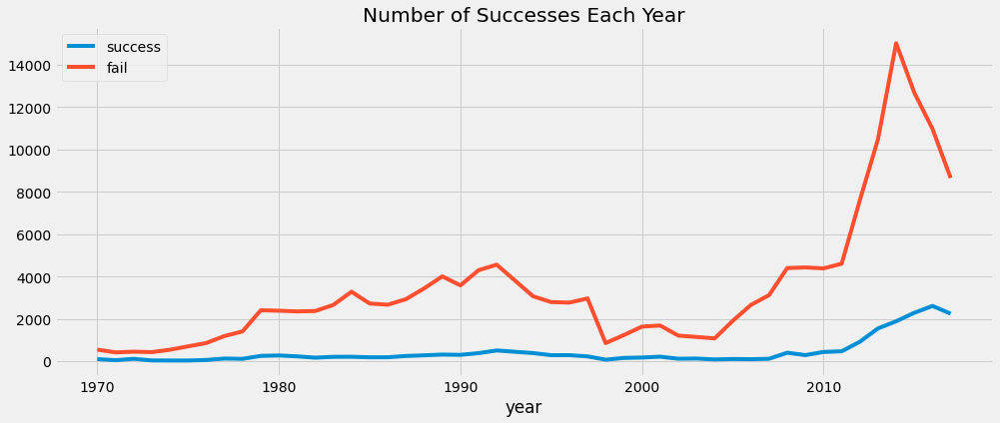

In [474]:
fig, ax = plt.subplots()
sucount = df.loc[df['success'] == 0, 'iyear'].value_counts()
facount = df.loc[df['success'] == 1, 'iyear'].value_counts()
sns.lineplot(x=sucount.index, y=sucount.values, palette='flare', ax=ax, label='success')
sns.lineplot(x=facount.index, y=facount.values, palette='flare', ax=ax, label='fail')
plt.legend()
plt.xlabel("year")
plt.title("Number of Successes Each Year")
plt.show()

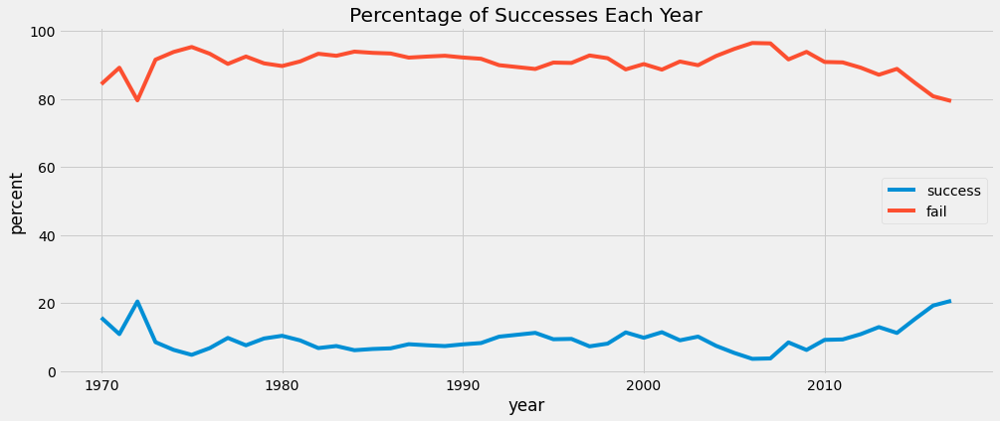

In [473]:
fig, ax = plt.subplots()
percent = df.groupby('iyear')['success'].value_counts(normalize=True).mul(100).rename('percent').reset_index()
sucount = percent[percent['success'] == 0]
facount = percent[percent['success'] == 1]
sns.lineplot('iyear', 'percent', data=sucount, palette='flare', ax=ax, label='success')
sns.lineplot('iyear', 'percent', data=facount, palette='flare', ax=ax, label='fail')
plt.xlabel("year")
plt.legend()
plt.title("Percentage of Successes Each Year")
plt.show()

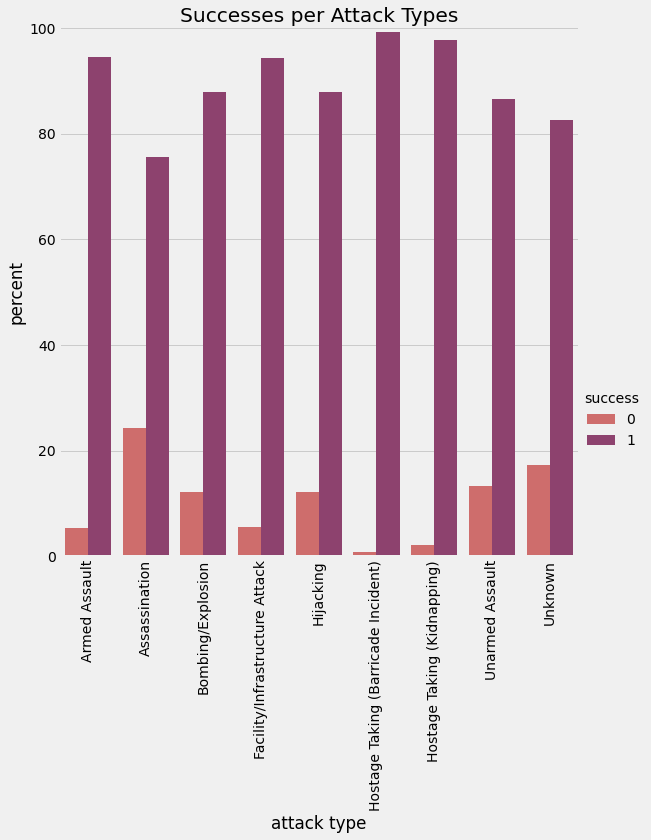

In [476]:
tmp = df.groupby('attacktype1_txt')['success'].value_counts(normalize=True)
tmp = tmp.mul(100)
tmp = tmp.rename('percent').reset_index()

sns.catplot(x='attacktype1_txt', y='percent', hue='success', data=tmp, kind='bar', palette='flare', size=8)
plt.ylim(0, 100)
plt.xticks(rotation=90)
plt.xlabel('attack type')
plt.title('Successes per Attack Types')
plt.show()

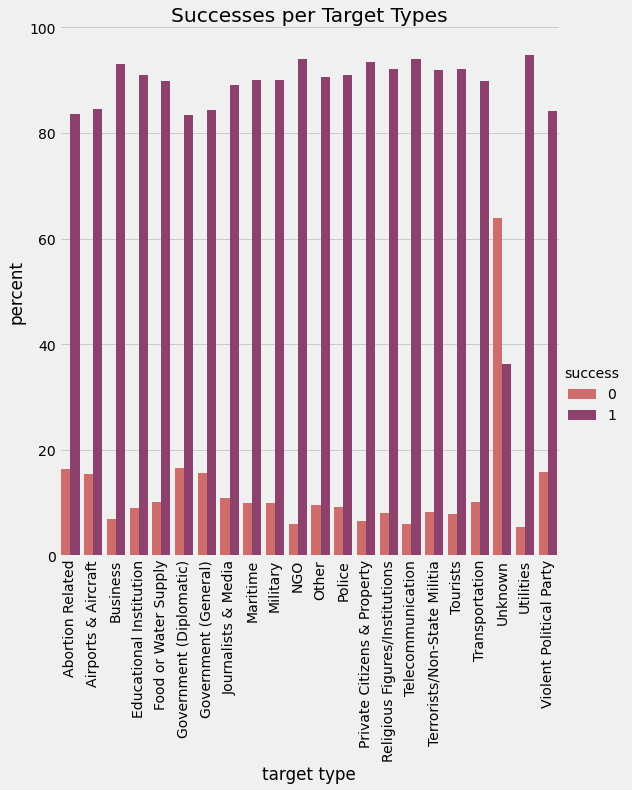

In [477]:
tmp = df.groupby('targtype1_txt')['success'].value_counts(normalize=True)
tmp = tmp.mul(100)
tmp = tmp.rename('percent').reset_index()

sns.catplot(x='targtype1_txt', y='percent', hue='success', data=tmp, kind='bar', palette='flare', size=8)
plt.ylim(0, 100)
plt.xlabel('target type')
plt.xticks(rotation=90)
plt.title('Successes per Target Types')
plt.show()

Выводы по успешности террористических атак:
1. Не вижу зависимости успешности террористических атак со временем.
2. Наиболее успешный типа атаки -- захват заложников, наименее успешный -- убийство.
3. Успех/неуспех мало зависят от типа цели, но наименее успешные атаки на правительство и дипломатов (за исключением Unknown: если атака провалилась, то может и не быть известна ее конечная цель), а наиболее успешные -- на инфраструктуры.

Немного словесного анализа -- рассмотрим текстовую колонку "motive" и вытащим наиболее распространенные слова.

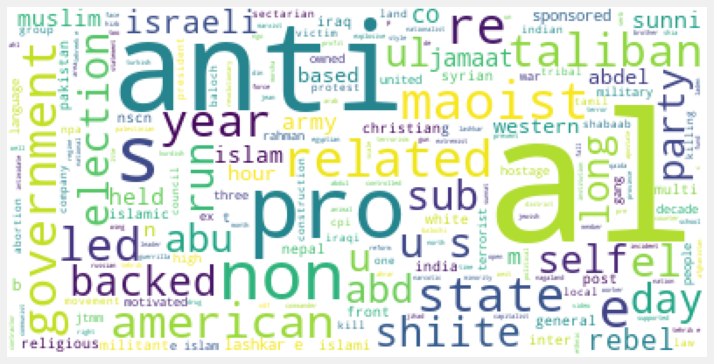

In [491]:
import nltk
from wordcloud import WordCloud, STOPWORDS

motive = df['motive'].str.lower().str.replace(r'\|', ' ').str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(motive)
word_dist = nltk.FreqDist(words)
stopwords = nltk.corpus.stopwords.words('english')
words_dist = nltk.FreqDist(w for w in words if w not in stopwords)
wordcloud = WordCloud(stopwords=STOPWORDS, background_color='white').generate(" ".join(words_dist))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

Исследуем террористические атаки в России. Начнем с карты за все годы в датасете.

In [481]:
tmp = df[df['country_txt'] == 'Russia']
print(f"Maximum people killed in the attack: {tmp['nkill'].max()} in {tmp.loc[tmp['nkill'].idxmax(), 'city']}, {tmp.loc[tmp['nkill'].idxmax(), 'iyear']} by {tmp.loc[tmp['nkill'].idxmax(), 'gname']}")
print(f"Maximum casualities in the attack: {tmp['ncas'].max()} in {tmp.loc[tmp['ncas'].idxmax(), 'city']}, {tmp.loc[tmp['ncas'].idxmax(), 'iyear']} by {tmp.loc[tmp['ncas'].idxmax(), 'gname']}")
print(f"Most active perpetrator groups:\n\t{tmp['gname'].value_counts().index[1]} : {tmp['gname'].value_counts()[1]}\n\t{tmp['gname'].value_counts().index[2]} : {tmp['gname'].value_counts()[2]}")

Maximum people killed in the attack: 344 in Beslan, 2004 by Riyadus-Salikhin Reconnaissance and Sabotage Battalion of Chechen Martyrs
Maximum casualities in the attack: 1071 in Beslan, 2004 by Riyadus-Salikhin Reconnaissance and Sabotage Battalion of Chechen Martyrs
Most active perpetrator groups:
	Chechen Rebels : 321
	Caucasus Emirate : 44


In [480]:
tmp = df[['country_txt', 'latitude', 'longitude', 'iyear', 'imonth', 'iday', 'ncas', 'gname']]
tmp = tmp.dropna()
tmp = tmp[tmp['country_txt'] == 'Russia']

lats = tmp.latitude
longs = tmp.longitude
places=[[x[0],x[1]] for x in zip(lats,longs)]
years = tmp.iyear
months = tmp.imonth
days = tmp.iday
ncass = tmp.ncas
gnames = tmp.gname
info = zip(years, months, days, ncass, gnames)
popups = [f"{day}.{month}.{year}<br>casualties: {ncas}<br>perpetrators: {gname}" for year, month, day, ncas, gname in info]

m = folium.Map(places[0], tiles = 'OpenStreetMap', zoom_start=2)
plugins.MarkerCluster(places, popups=popups).add_to(m)

m

In [492]:
ru = df[df['country_txt'] == 'Russia']

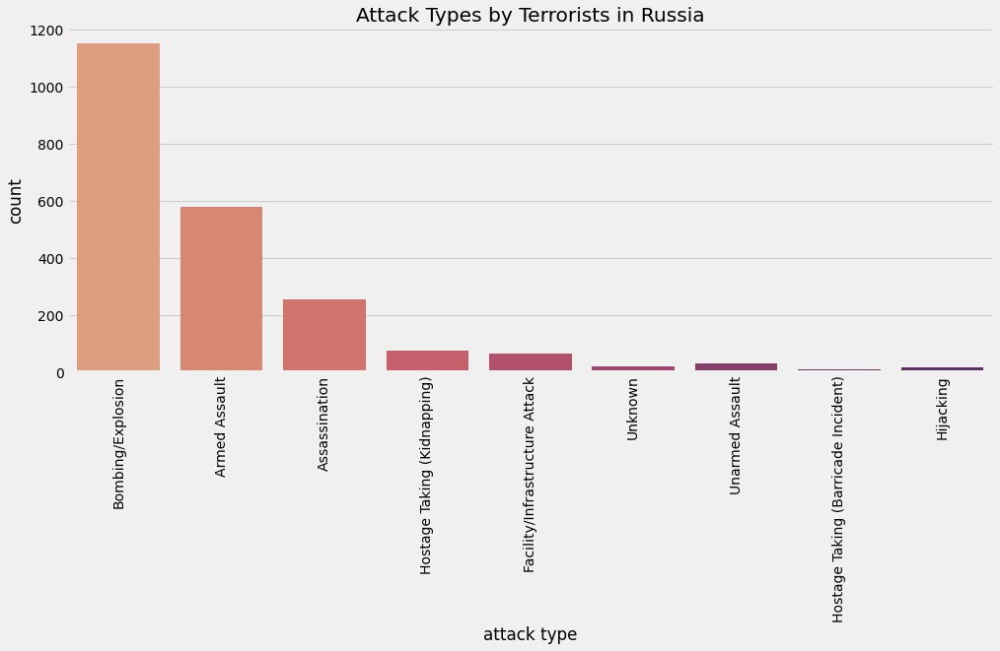

In [502]:
sns.countplot('attacktype1_txt', data=ru, palette='flare', order=df['attacktype1_txt'].value_counts().index)
plt.xticks(rotation=90)
plt.xlabel("attack type")
plt.title("Attack Types by Terrorists in Russia")
plt.show()

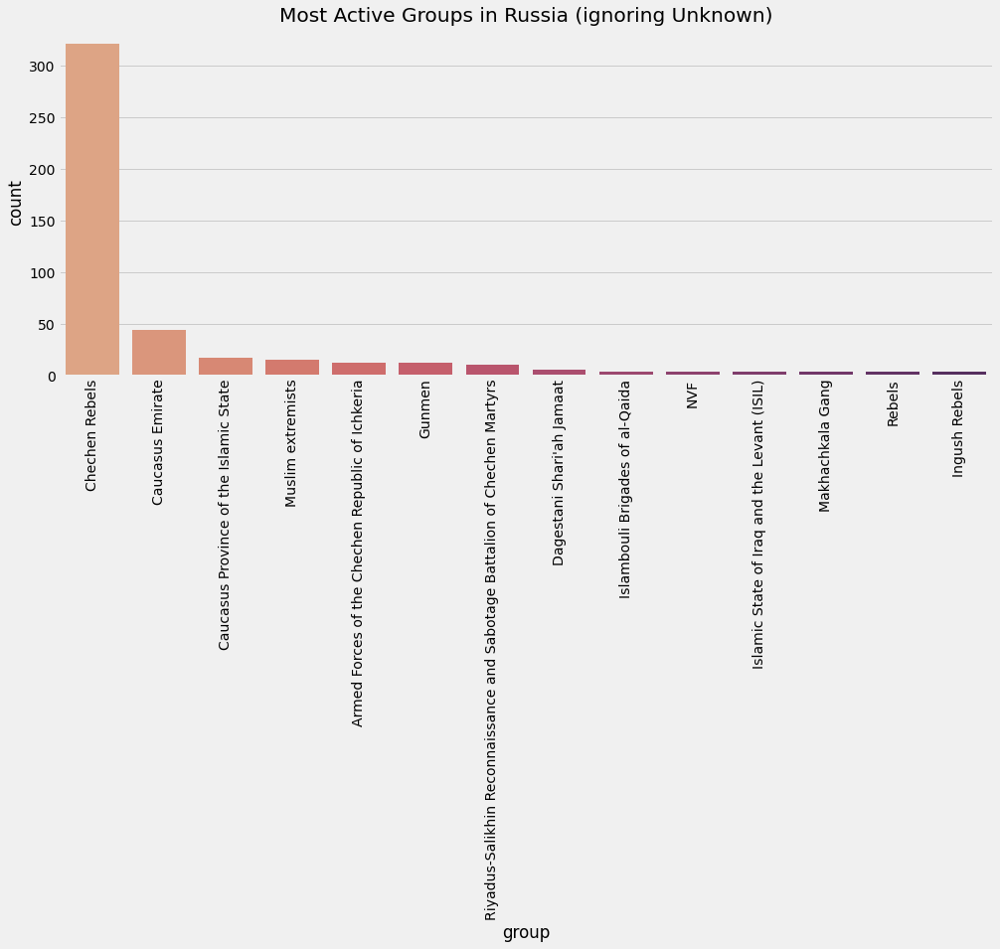

In [506]:
sns.countplot('gname', data=ru, palette='flare', order=ru['gname'].value_counts().index[1:15])
plt.xticks(rotation=90)
plt.xlabel("group")
plt.title("Most Active Groups in Russia (ignoring Unknown)")
plt.show()

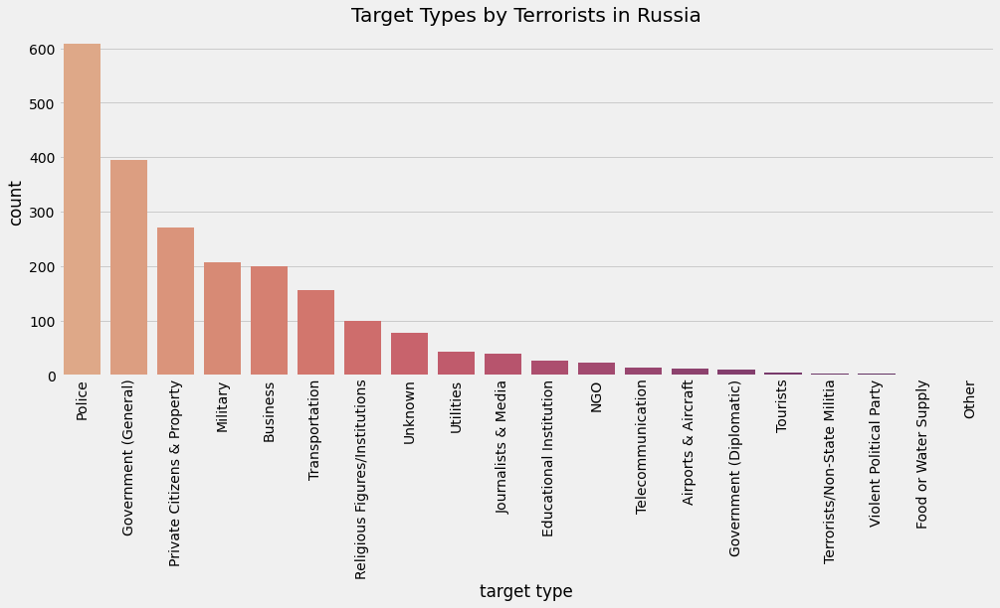

In [508]:
sns.countplot('targtype1_txt', data=ru, palette='flare', order=ru['targtype1_txt'].value_counts().index)
plt.xticks(rotation=90)
plt.xlabel("target type")
plt.title("Target Types by Terrorists in Russia")
plt.show()

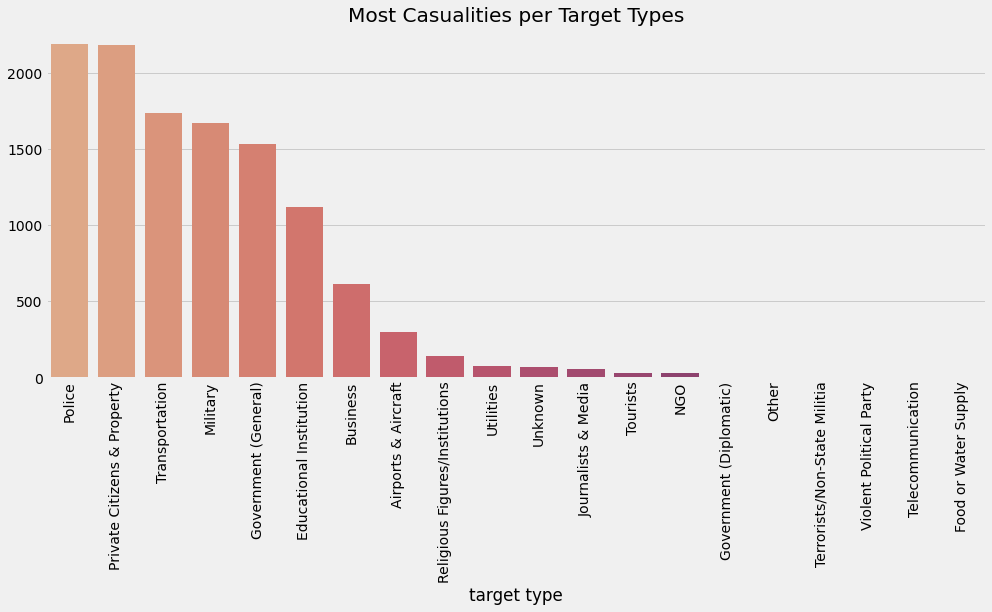

In [499]:
tmp = ru.groupby('targtype1_txt')['ncas'].sum().sort_values(ascending=False)
sns.barplot(x=tmp.index, y=tmp.values, palette='flare')
plt.xticks(rotation=90)
plt.xlabel("target type")
plt.title("Most Casualities per Target Types")
plt.show()

Так же, как и в мире, наиболее популярный тип атаки -- взрывчатка. Наиболее активные криминальные группировки -- чеченские повстанцы/боевики и Кавказский Эмират. Замечен тренд, отличающийся от мира: террористы в России предпочитают нападать на полицию и правительство, причем наибольшее число жертв приносят нападения на полицию и частные лица.

Вернемся с основному датасету. Взглянем на хитмап корреляций между столбцами. Будем использовать хитмап как подсказку связей, которые не удалось рассмотреть.

<AxesSubplot:>

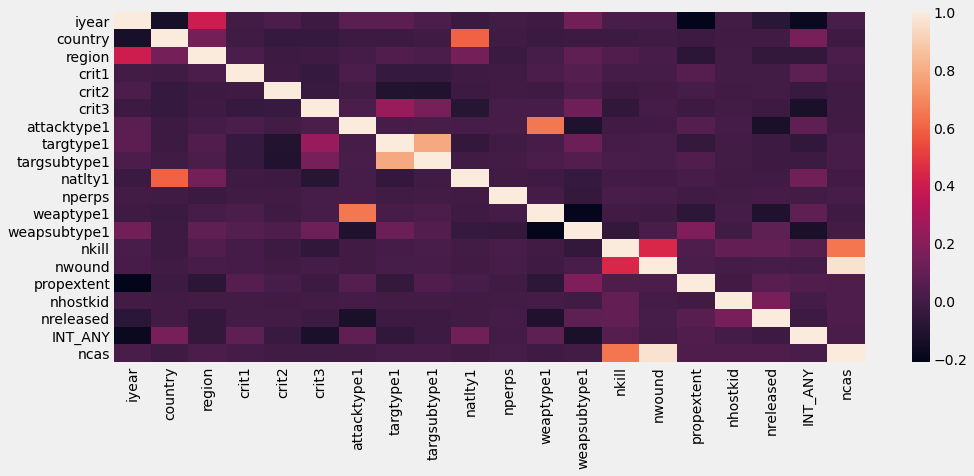

In [530]:
cor_df = df.drop(['country_txt', 'region_txt', 'latitude', 'longitude', 'attacktype1_txt', 'targtype1_txt',\
                  'targsubtype1_txt', 'natlty1_txt', 'corp1', 'target1', 'motive', 'weaptype1_txt',\
                  'weapsubtype1_txt', 'imonth', 'iday', 'claimed', 'success', 'suicide', 'property',\
                  'extended', 'individual'], axis=1)
sns.heatmap(cor_df.corr(), xticklabels=True, yticklabels=True)

Некоторые корреляции очевидны -- например, корреляция ncas и nkill/nwound (ncas=nkill+nwound), targsubtype1 и targtype1 (targsubtype1 зависит от targtype1 по Codebook). Интересные корреляции:
* natlty1 и country -- национальность атакованной цели и страна атаки.
* crit3 и targtype1 -- критерий того, вне ли гуманитарного закона атака, и тип цели.
* attacktype1 и weaptype1 -- тип атаки и использованное оружие.

Исследуем их.

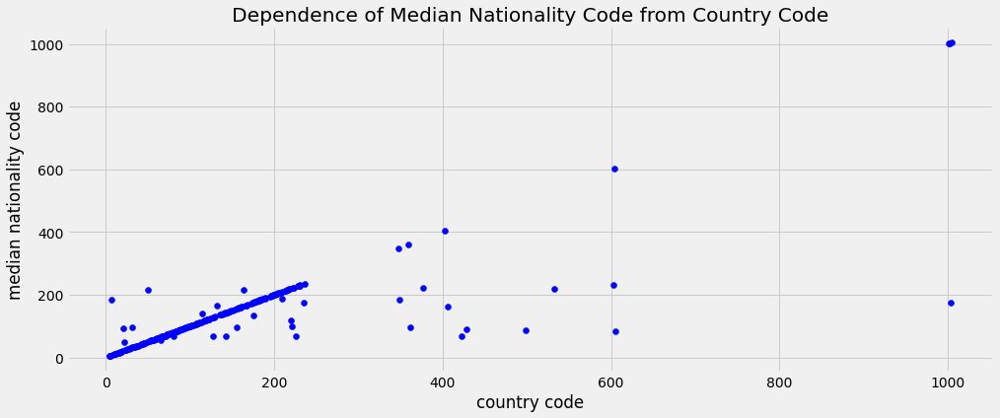

In [551]:
for c in df['country'].unique():
    plt.scatter(x=c, y=df[df.country == c]['natlty1'].median(), color='blue')
plt.title('Dependence of Median Nationality Code from Country Code')
plt.xlabel('country code')
plt.ylabel('median nationality code')
plt.show()

Наблюдается явная линейная зависимость для кодов стран атаки и национальностей целей, причем страна атаки == национальность цели. Таким образом, террористы обычно нападают на принадлежащие стране атаки цели.

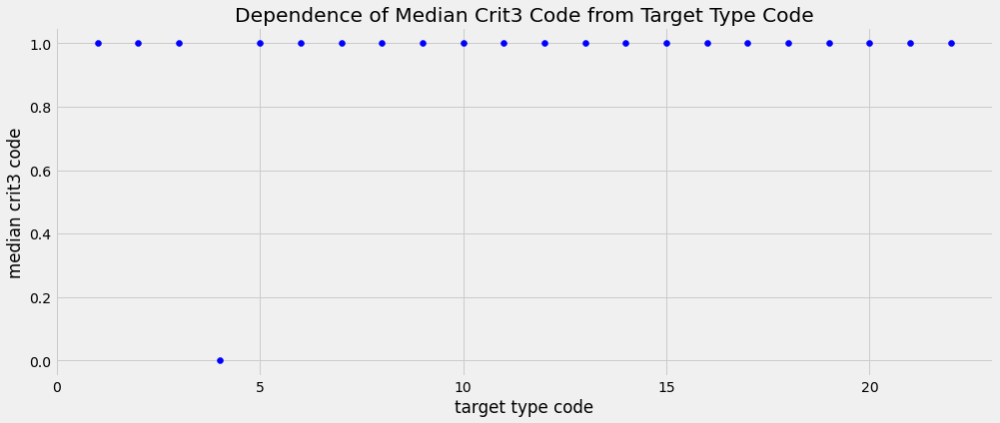

In [566]:
for t in df['targtype1'].unique():
    plt.scatter(x=t, y=df[df.targtype1 == t]['crit3'].median(), color='blue')
plt.title('Dependence of Median Crit3 Code from Target Type Code')
plt.xlabel('target type code')
plt.ylabel('median crit3 code')
plt.show()

Наблюдается константная связь типа цели и критерия 3, определяющего, выходит ли атака за гуманитарные законы. Причем тип цели 4 (армия) соответствует 0 значению критерия 3, то есть атака не выходит за гуманитарные законы. Это интуитивно понятно (боевые действия).

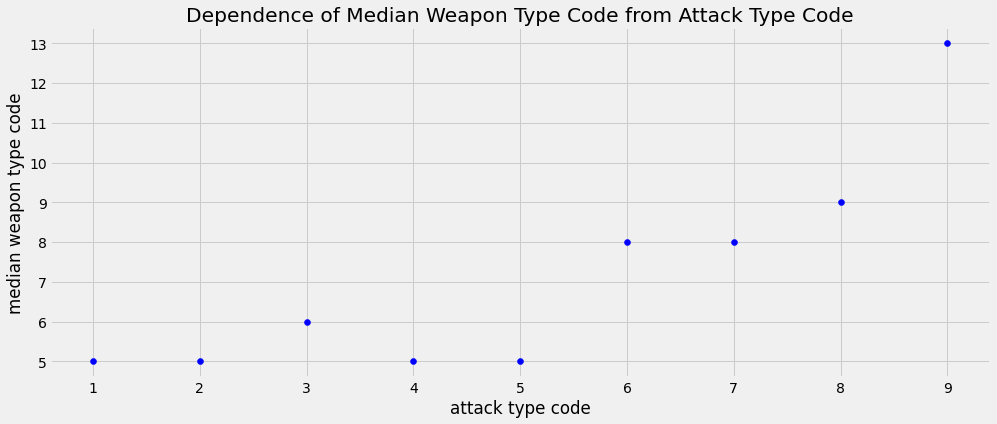

In [558]:
for a in df['attacktype1'].unique():
    plt.scatter(x=a, y=df[df.attacktype1 == a]['weaptype1'].median(), color='blue')
plt.title('Dependence of Median Weapon Type Code from Attack Type Code')
plt.xlabel('attack type code')
plt.ylabel('median weapon type code')
plt.show()

Это ложная линейная зависимость -- коды не упорядочены и их можно просто переставить.

Но можно посчитать корреляцию Крамера для категориальных переменных.

In [563]:
def cramers_corrected_stat(confusion_matrix):
    """ calculate Cramers V statistic for categorial-categorial association.
        uses correction from Bergsma and Wicher, 
        Journal of the Korean Statistical Society 42 (2013): 323-328
    """
    chi2 = scipy.stats.chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2/n
    r,k = confusion_matrix.shape
    phi2corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))    
    rcorr = r - ((r-1)**2)/(n-1)
    kcorr = k - ((k-1)**2)/(n-1)
    return np.sqrt(phi2corr / min( (kcorr-1), (rcorr-1)))

Построим хитмап для категориальных переменных.

<AxesSubplot:>

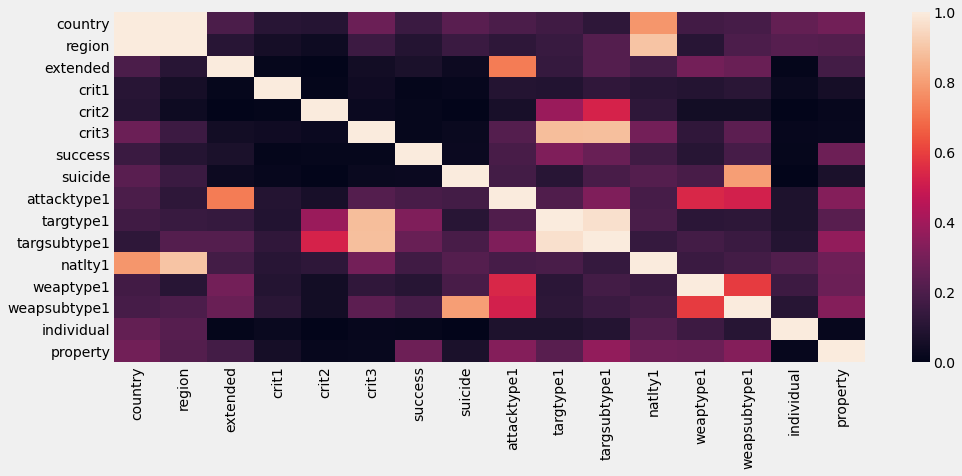

In [576]:
cat_df = df[['country', 'region', 'extended', 'crit1', 'crit2', 'crit3',\
             'success', 'suicide', 'attacktype1', 'targtype1', 'targsubtype1','natlty1',\
             'weaptype1', 'weapsubtype1', 'individual', 'property']]

rows = []
for col1 in cat_df:
    col = []
    for col2 in cat_df:
        confusion_matrix = pd.crosstab(cat_df[col1], cat_df[col2])
        cor = cramers_corrected_stat(confusion_matrix)
        col.append(cor)
    rows.append(col)
corrm = np.array(rows)        
cram_res = pd.DataFrame(corrm, index=cat_df.columns, columns=cat_df.columns)
sns.heatmap(data=cram_res, xticklabels=True, yticklabels=True)

Какие корреляции заметны:
* country и region -- страна и регион атаки
* natlty1 и country, region -- национальность цели и страна/регион атаки
* crit3 и targtype1, targsubtype1 -- критерий того, находится ли атака вне гуманитарного закона, и тип/субтип цели
* suicide и weapsubtype1 -- суицидальность атаки и субтип оружия (один из субтипов оружия -- суицид)
* targsubtype1 и crit2 -- субтип цели и критерий того, что атака проведена с целью устрашения, убеждения или распространения идеи

Последнее особенно интересно. 

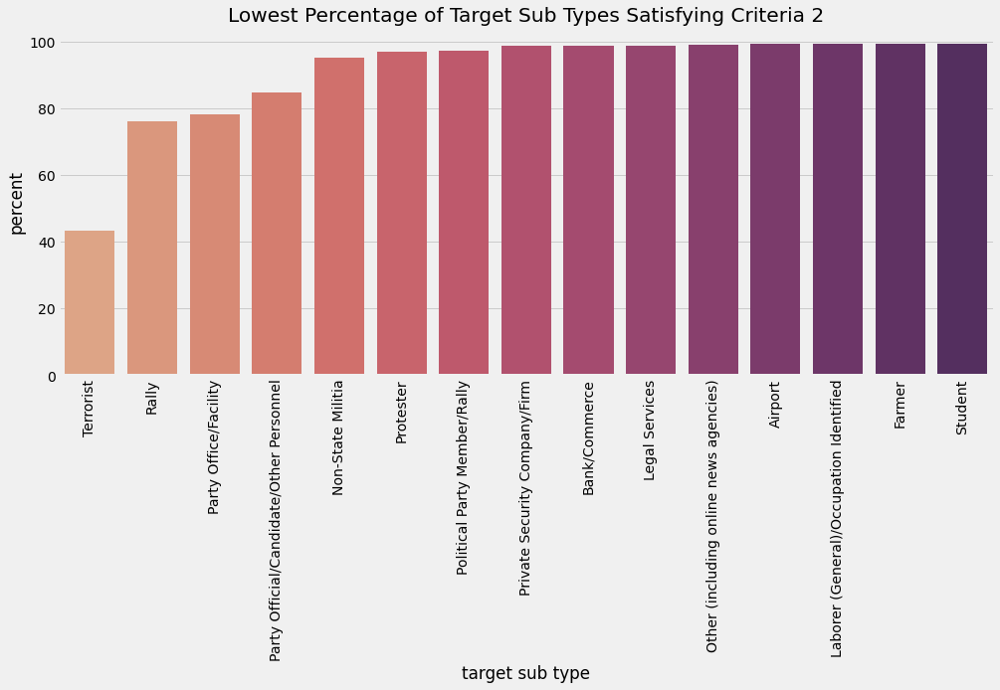

In [616]:
percent = df.groupby('targsubtype1_txt')['crit2'].value_counts(normalize=True).mul(100).rename('percent').reset_index()
iscount = percent[percent['crit2'] == 1].sort_values('percent')[:15]
sns.barplot('targsubtype1_txt', 'percent', data=iscount, palette='flare')
plt.xlabel("target sub type")
plt.xticks(rotation=90)
plt.title("Lowest Percentage of Target Sub Types Satisfying Criteria 2")
plt.show()

Получается, меньше всего террористические атаки с целью убедить или устрашить проводились тогда, когда цель:
* террористические и негосударственные боевые организации
* массовые митинги, партийные чиновники и партийный офис (насильственных партий, см. Codebook)

Взглянем на временные ряды. Например, на 2017 год.

<AxesSubplot:title={'center':'Casualties by Terrorist Attacks in 2017'}>

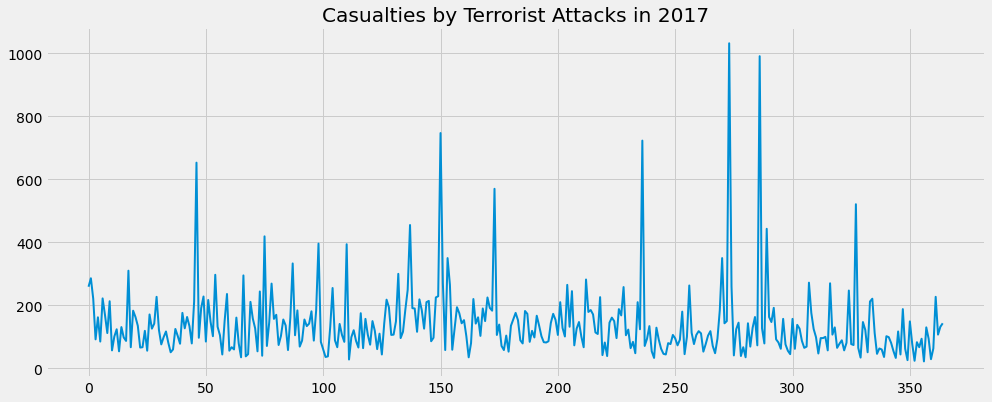

In [84]:
df['date'] = pd.to_datetime(df.iyear*10000+df.imonth*100+df.iday,format='%Y%m%d', errors='coerce')
tmp = df[df.iyear == 2017]
cas_tmp = tmp.groupby('date')['ncas'].sum()
cas_tmp = cas_tmp.reset_index()
cas_tmp.ncas.plot(title='Casualties by Terrorist Attacks in 2017', fontsize=14, linewidth=2)

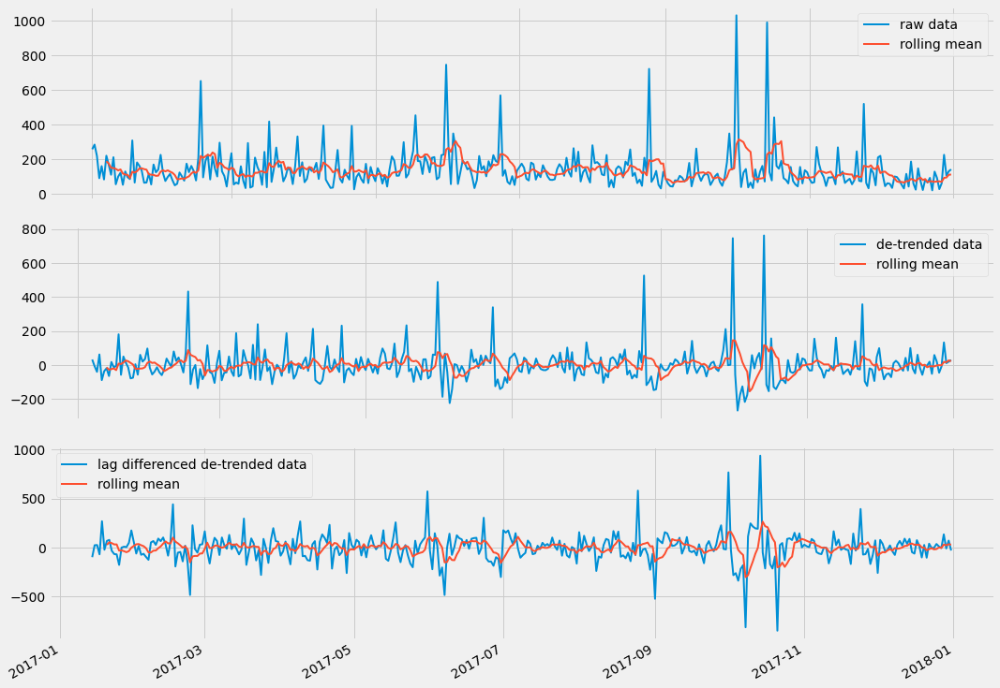

In [135]:
fig, axes = plt.subplots(3, figsize=(15, 12))

window = 7
cas_tmp['z_ncas'] = cas_tmp['ncas'] - cas_tmp.ncas.rolling(window).mean()
cas_tmp['zp_ncas'] = cas_tmp['z_ncas'] - cas_tmp.z_ncas.shift(window)

axes[0].plot(cas_tmp.date, cas_tmp.ncas, label='raw data', linewidth=2)
axes[0].plot(cas_tmp.date, cas_tmp.ncas.rolling(window=window).mean(), label='rolling mean', linewidth=2)
axes[0].legend()
axes[1].plot(cas_tmp.date, cas_tmp.z_ncas, label='de-trended data', linewidth=2)
axes[1].plot(cas_tmp.date, cas_tmp.z_ncas.rolling(window=window).mean(), label='rolling mean', linewidth=2)
axes[1].legend()
axes[2].plot(cas_tmp.date, cas_tmp.zp_ncas, label='lag differenced de-trended data', linewidth=2)
axes[2].plot(cas_tmp.date, cas_tmp.zp_ncas.rolling(window=window).mean(), label='rolling mean', linewidth=2)
axes[2].legend()

plt.tight_layout()
fig.autofmt_xdate()

На последнем графике видно маленькую амплитуду колебаний. Причем период этих колебаний на глаз довольно стабилен. Может ли тут быть недельная сезонность? Разложим временной ряд на компоненты.

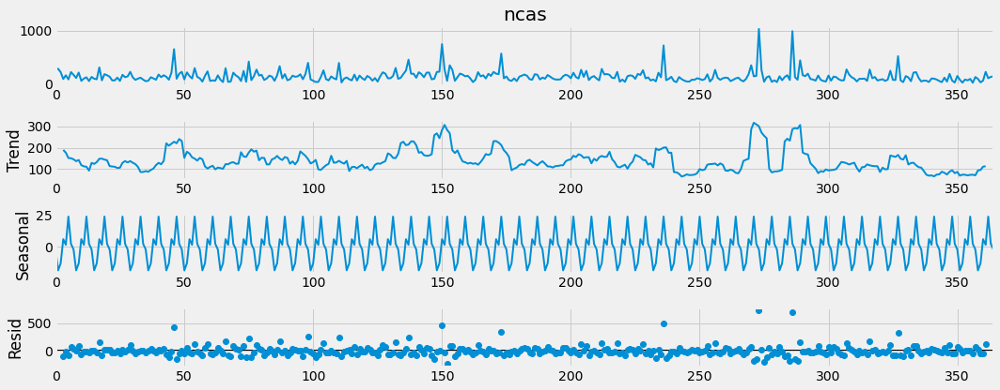

In [138]:
plt.rcParams['lines.linewidth'] = 2
decomp = sm.tsa.seasonal_decompose(cas_tmp.ncas, model='additive', period=7)
decomp.plot()
plt.show()

Похоже на недельную сезонность. Максимумы соответствуют окончанию недели и выходным: в выходные многие отдыхают в местах скопления людей и жертв больше. В тренде не заметно глобальных изменений в зависимости от праздников или времени года, есть несколько всплесков, связанных с массовыми терактами.

# Проверка статистических гипотез <a class="anchor" id="header4"></a>

**Гипотеза 1**

Активность запрещенной в РФ ИГИЛ против частных лиц равна активности запрещенного в РФ Талибана против частных лиц.

H0 -- доля атак запрещенных в РФ Талибана и ИГИЛ на граждан одинаковая

H1 -- доля атак запрещенного в РФ ИГИЛ на граждан больше, чем доля атак запрещенного в РФ Талибана

In [709]:
from statsmodels.stats.proportion import proportions_ztest
count = [df[(df.gname == 'Taliban') & (df.targtype1 == 14)]['gname'].value_counts()[0],\
         df[(df.gname == 'Islamic State of Iraq and the Levant (ISIL)') & (df.targtype1 == 14)]['gname'].value_counts()[0]]
nobs = [df[df.gname == 'Taliban']['gname'].value_counts()[0], df[df.gname == 'Islamic State of Iraq and the Levant (ISIL)']['gname'].value_counts()[0]]
proportions_ztest(count, nobs, alternative='smaller')

(-26.641089834524493, 1.1350122127298013e-156)

Исходная гипотеза подтвердилась.

**Гипотеза 2**

Среднее число жертв в террористических атаках в Ираке после 2009 года больше, чем до.

<AxesSubplot:title={'center':'Distribution of casualties by terrorist attacks after 2009'}, xlabel='ncas', ylabel='Density'>

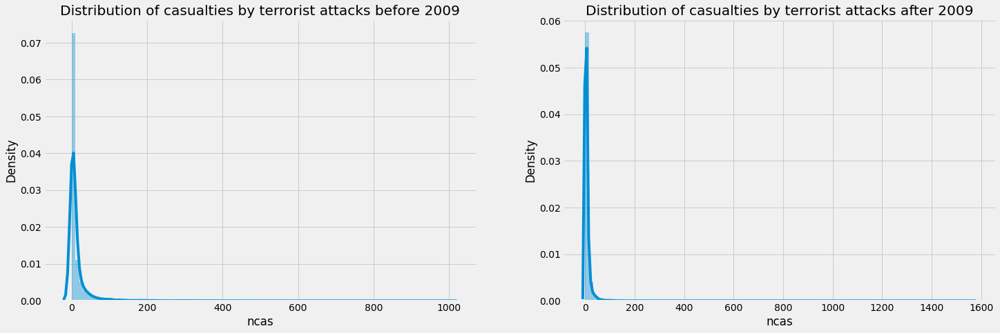

In [657]:
tmp = df[df.country_txt == 'Iraq']

fig = plt.figure(figsize=(22, 7))
ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)
ax1.set_title("Distribution of casualties by terrorist attacks before 2009")
ax2.set_title("Distribution of casualties by terrorist attacks after 2009")
sns.distplot(tmp[tmp.iyear <= 2009]['ncas'], bins=100, ax=ax1)
sns.distplot(tmp[tmp.iyear > 2009]['ncas'], bins=100, ax=ax2)

H0 -- после 2009 больше

H1 -- после 2009 меньше

In [656]:
scipy.stats.mannwhitneyu(tmp[tmp.iyear <= 2009]['ncas'], tmp[tmp.iyear > 2009]['ncas'], alternative='greater')

MannwhitneyuResult(statistic=55647168.5, pvalue=3.880755770238968e-19)

Нулевая гипотеза отвергается. Среднее число жертв в террористических атаках в Ираке до 2009 года больше, чем после.

# Предсказание временного ряда <a class="anchor" id="header5"></a>

Будем предсказывать число жертв в террористических атаках за некоторый промежуток времени в дневном масштабе.

In [88]:
tmp = df[df.iyear == 2017]
cas_tmp = tmp.groupby('date')['ncas'].sum()
cas_tmp = cas_tmp.reset_index()

In [104]:
train = cas_tmp.iloc[:-50]
test = cas_tmp.iloc[-50:-30]
num_test = 20
train.index = train.date
train.drop(['date'], axis=1, inplace=True)
test.index = test.date
test.drop(['date'], axis=1, inplace=True)

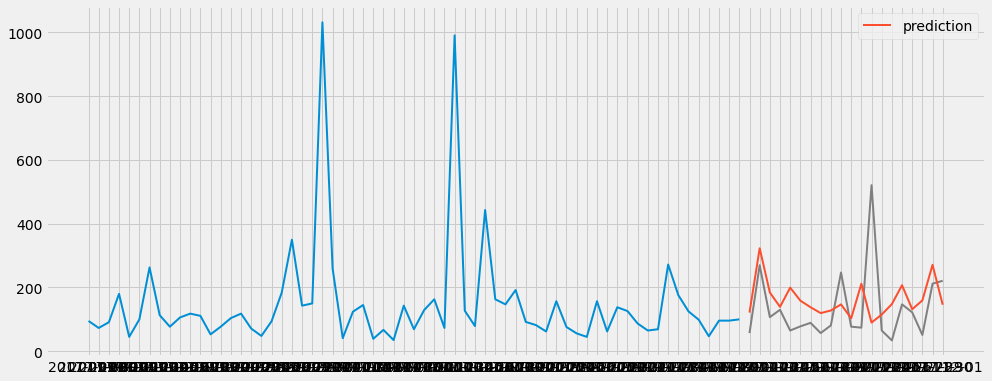

In [141]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing
model = ExponentialSmoothing(np.asarray(train['ncas']), damped=False, seasonal='add', trend='add', seasonal_periods=30)
fit1 = model.fit(optimized = True)
pred1 = fit1.forecast(num_test)

fig, ax = plt.subplots()
ax.plot(train.index[250:].astype(str), train.ncas[250:])
ax.plot(test.index.astype(str), test.ncas, color='gray')
ax.plot(test.index.astype(str), pred1, label='prediction')
plt.legend()

Не очень хорошее предсказание. Проблема в том, что, хоть и наблюдаются определенные зависимости во временном ряде, политическая и социальная обстановка в мире имеет большое влияние. А эти фичи недоступны в данном датасете.

# Выводы <a class="anchor" id="header6"></a>

**1) Подтверждена зависимость активности террористических атак от политической и военной обстановки в мире.**

**2) Построены карты, позволяющие визуально оценить масштаб бедствия.**

**3) Проведен словесный анализ мотивов преступников.**

**4) Наиболее подверженные атакам страны -- Ирак, Пакистан и Афганистан, а цели -- частные лица, полиция и армия. Не обнаружено сильной зависимости успешности террористической атаки от цели или оружия.**

**5) Исследована обстановка на территории РФ. Обнаружено отличие от данных по миру в том, что в РФ основные цели террористов -- полиция и правительство.**

**6) Террористические атаки с целью устрашения реже всего проводятся против других боевых/террористических организаций и насильственных партий.**

**7) Исследован временной ряд. Вдобавок к явной зависимости от обстановки в мире обнаружена недельная сезонность. Сделано предсказание временного ряда.**

**8) Сделаны две статистические гипотезы: "Активности запрещеных в РФ организаций ИГИЛа и Талибана против частных лиц равны." Подтверждено. "Среднее число жертв терроризма в Ираке после 2009 больше, чем до." Опровергнуто.**